<a href="https://colab.research.google.com/github/AndrewBoessen/CSCI3387_Notebooks/blob/main/NeuralGameEngine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

If possible, use the T4 Nvidia GPU runtime for this demo to make it run faster

# Gameplay Video Demo
The following video is a screen recording from playing the simulated game.

This model is running on a single Nvidia RTX 4070 at 15 fps

_This is an actual person playing the game not an agent_

In [ ]:
from IPython.display import HTML

video_id = '1mXKjE1jZpSp8csSGZYUEjYCS-La_xzp9'
video_url = f'https://drive.google.com/file/d/{video_id}/preview'

html_code = f'''
<iframe src="{video_url}" width="512" height="512" allow="autoplay"></iframe>
'''

HTML(html_code)

# Download Model Code from Github and Install Dependencies

_When installing you may need to restart the session and run all cells again_

In [ ]:
!git clone -b crop-scale --single-branch https://github.com/AndrewBoessen/VQ-VAE.git

Cloning into 'VQ-VAE'...
remote: Enumerating objects: 250, done.
remote: Counting objects: 100% (21/21), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 250 (delta 4), reused 0 (delta 0), pack-reused 229 (from 1)
Receiving objects: 100% (250/250), 138.95 MiB | 14.05 MiB/s, done.
Resolving deltas: 100% (128/128), done.


In [ ]:
!git clone https://github.com/AndrewBoessen/neural-game-engine.git

Cloning into 'neural-game-engine'...
remote: Enumerating objects: 369, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 369 (delta 2), reused 1 (delta 1), pack-reused 366 (from 1)
Receiving objects: 100% (369/369), 119.81 KiB | 697.00 KiB/s, done.
Resolving deltas: 100% (213/213), done.


In [ ]:
%cd /content/VQ-VAE
!pip install -r requirements.txt

/content/VQ-VAE
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 42.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 1.1 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144555 sha256=cbc32ae732656314ed3312c1c65f5f98301f12760439171138ed8937b38edb3c
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime
  Attempting uninstall: sqlalchemy
    Found existing insta

In [ ]:
%cd /content/neural-game-engine
!pip install -r requirements.txt

/content/neural-game-engine
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 3.9 MB/s eta 0:00:00


In [ ]:
!pip install gdown

# Demo Image Auto-Encoder

In [ ]:
%cd /content/VQ-VAE

/content/VQ-VAE


## Download Model Checkpoint and Data

_If the downloads from Google Drive fail, delete the current runtime, reconnect and run all cells again_

In [ ]:
import gdown

file_id = "1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ"
output_file = "vqvae_checkpoint.pt"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False, proxy=None, speed=None, use_cookies=True, verify=True)

Downloading...
From (original): https://drive.google.com/uc?id=1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ
From (redirected): https://drive.google.com/uc?id=1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ&confirm=t&uuid=83415ab5-29aa-463e-8b08-f6eebf38fa87
To: /content/VQ-VAE/vqvae_checkpoint.pt
100%|██████████| 108M/108M [00:03<00:00, 27.2MB/s]


'vqvae_checkpoint.pt'

In [ ]:
import gdown

file_id = "1mr900bK0xpwiQskSB4KJvwtrbwtnEJcY"
output_file = "gameplay_data.zip"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False, proxy=None, speed=None, use_cookies=True, verify=True)

Downloading...
From (original): https://drive.google.com/uc?id=1mr900bK0xpwiQskSB4KJvwtrbwtnEJcY
From (redirected): https://drive.google.com/uc?id=1mr900bK0xpwiQskSB4KJvwtrbwtnEJcY&confirm=t&uuid=88d4fd62-5d26-4066-9401-774d18cc9284
To: /content/VQ-VAE/gameplay_data.zip
100%|██████████| 466M/466M [00:07<00:00, 63.1MB/s]


'gameplay_data.zip'

In [ ]:
!unzip gameplay_data.zip -d gameplay_data_256_no_crop

Archive:  gameplay_data.zip
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/actions/actions_shard_3.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/actions/actions_shard_2.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/actions/actions_shard_1.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/actions/actions_shard_0.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/actions_shard_16.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/actions_shard_15.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/actions_shard_14.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/actions_shard_13.npy  
  inflating: gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/actions_shard_12.npy  
  inflating: gameplay_data_256_no_crop/skiing_ag

In [ ]:
# Fix file structure
!mkdir gameplay_data_256_no_crop/val
!mkdir gameplay_data_256_no_crop/train

!mv gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/observations/* gameplay_data_256_no_crop/val/
!mv gameplay_data_256_no_crop/skiing_agent_data_scale_256/val/actions/* gameplay_data_256_no_crop/val/

!mv gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/observations/* gameplay_data_256_no_crop/train/
!mv gameplay_data_256_no_crop/skiing_agent_data_scale_256/train/actions/* gameplay_data_256_no_crop/train/

## Run Auto-Encoder Demo

_This takes a long time to run_

In [ ]:
from gameplay_dataset_reader import GameFrameDataset
from train_tokenizer import EncoderDecoderConfig, load_config
from vqvae import Decoder, Encoder, Tokenizer
from demo import analyze_embeddings_umap, visualize_reconstructions, load_checkpoint
import torch

In [ ]:
# Load configuration
config_path = "config_256.yaml"
config = load_config(config_path)
# Create encoder/decoder config from loaded configuration
encoder_decoder_config = EncoderDecoderConfig(
    resolution=config["encoder"]["config"]["resolution"],
    in_channels=config["encoder"]["config"]["in_channels"],
    z_channels=config["encoder"]["config"]["z_channels"],
    ch=config["encoder"]["config"]["ch"],
    ch_mult=tuple(config["encoder"]["config"]["ch_mult"]),
    num_res_blocks=config["encoder"]["config"]["num_res_blocks"],
    attn_resolutions=tuple(config["encoder"]["config"]["attn_resolutions"]),
    out_ch=config["encoder"]["config"]["out_ch"],
    dropout=config["encoder"]["config"]["dropout"],
)
# Load data
val_path = "gameplay_data_256_no_crop/val/"
data = GameFrameDataset(val_path)
# Initialize model components using config values
encoder = Encoder(config=encoder_decoder_config)
decoder = Decoder(config=encoder_decoder_config)
# Initialize model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Initialize Tokenizer using config values
model = Tokenizer(
    vocab_size=config["vocab_size"],
    embed_dim=config["embed_dim"],
    encoder=encoder,
    decoder=decoder,
    with_lpips=True,
).to(device)

Tokenizer : shape of latent is (512, 16, 16).


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 163MB/s]


8.19kB [00:00, 605kB/s]                    
/content/VQ-VAE/lpips.py:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  torch.load(ckpt, map_location=torch.device("cpu")), st

In [ ]:
# Load checkpoint
checkpoint_path = "vqvae_checkpoint.pt"  # Adjust path as needed
model = load_checkpoint(model, checkpoint_path, device)
print("Model loaded successfully.")


/content/VQ-VAE/demo.py:20: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Model loaded successfully.


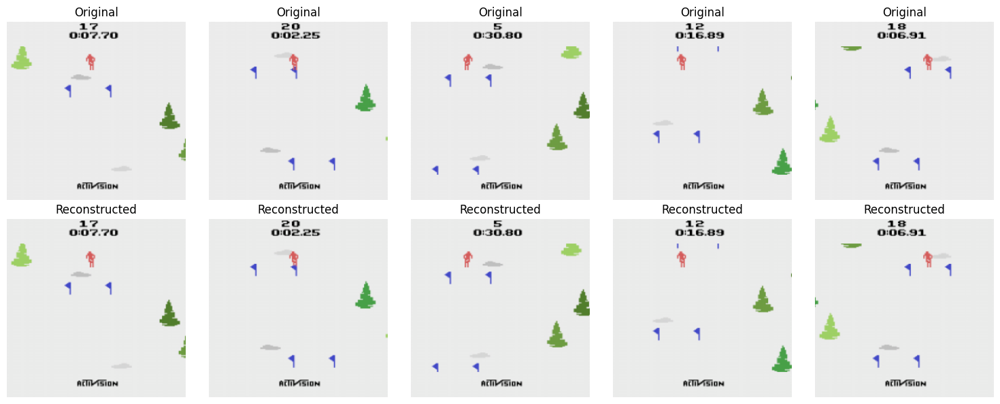

In [ ]:
# Visualize reconstructions
visualize_reconstructions(model, data)

100%|██████████| 32/32 [02:23<00:00,  4.48s/it]
/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


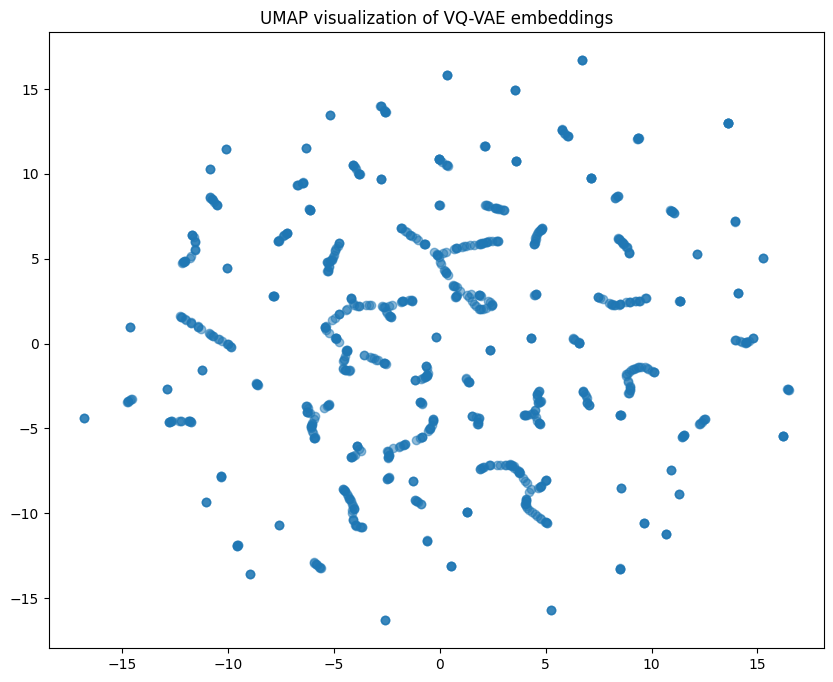

In [ ]:
# Run UMAP clustering on sample of 1000 embeddings
analyze_embeddings_umap(model, data)

100%|██████████| 20/20 [02:21<00:00,  7.07s/it]


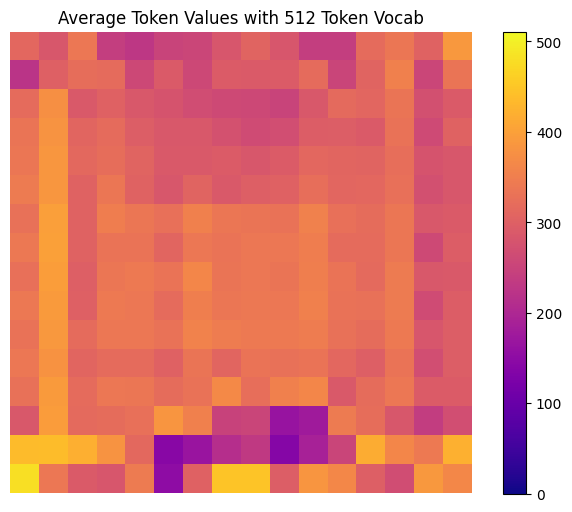

In [ ]:
# Run analysis on codebook usage
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from einops import rearrange
num_samples = 1000
batch_size = 50
model.eval()
with torch.no_grad():
    # Select random samples
    indices = np.random.choice(len(data), num_samples, replace=False)

    # Initialize list to store embeddings
    all_tokens = []

    # Process in batches
    for start_idx in tqdm(range(0, num_samples, batch_size)):
        end_idx = min(start_idx + batch_size, num_samples)
        batch_indices = indices[start_idx:end_idx]
        samples = torch.stack([data[i]["image"] for i in batch_indices]).to(
            next(model.parameters()).device
        )
        # Get embeddings for the current batch
        batch_embeddings = model.encode(samples)
        tokens = (
            batch_embeddings.tokens.view(len(batch_indices), 16, 16).cpu().numpy()
        )
        # Append to the list of all embeddings
        all_tokens.append(tokens)
    # Concatenate all batch embeddings into a single array
    tokens_matrix = np.concatenate(all_tokens, axis=0)
    # Calculate the average of all 100 grids
    average_grid = np.mean(tokens_matrix, axis=0)

    # Create the plot
    plt.figure(figsize=(8, 6))
    im = plt.imshow(average_grid, cmap='plasma', vmin=0, vmax=511)
    plt.colorbar(im)
    plt.title('Average Token Values with 512 Token Vocab')
    plt.axis('off')
    plt.show()

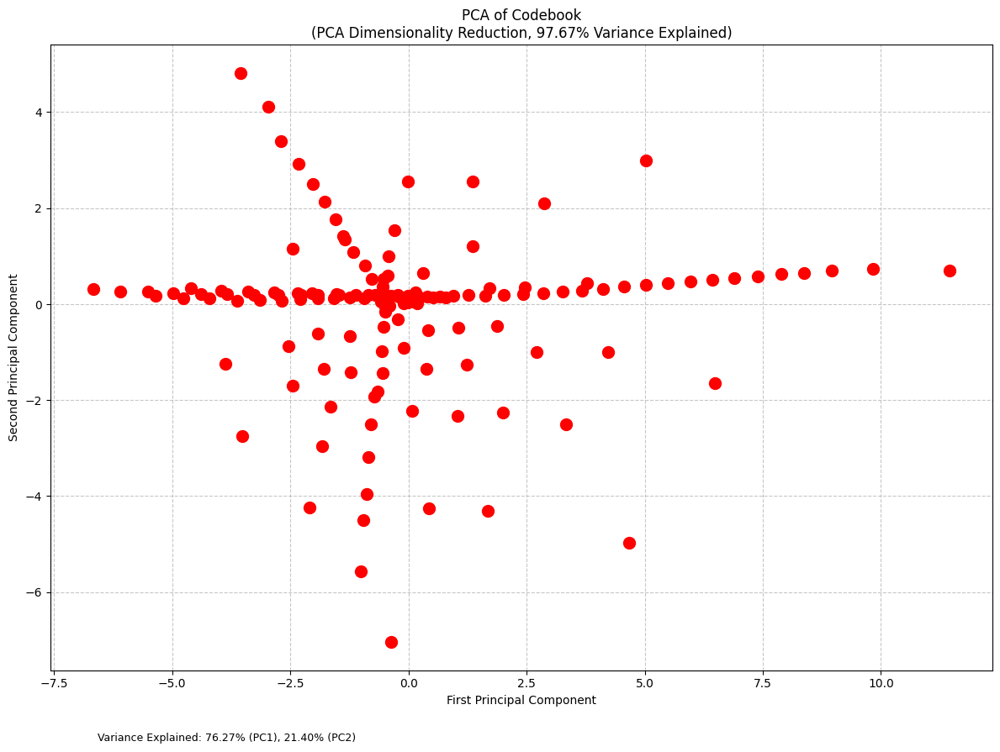

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial import Voronoi
from sklearn.decomposition import PCA

centers = model.embedding.weight.data.cpu().numpy()
pca = PCA(n_components=2)
cluster_centers_2d = pca.fit_transform(centers)

# Plotting
plt.figure(figsize=(12, 9))

# Plot cluster centers
plt.scatter(cluster_centers_2d[:, 0], cluster_centers_2d[:, 1],
            c='red', s=100, zorder=2)

# Compute and display explained variance
explained_variance = pca.explained_variance_ratio_
total_variance = np.sum(explained_variance) * 100

plt.title('PCA of Codebook\n'
          f'(PCA Dimensionality Reduction, {total_variance:.2f}% Variance Explained)',
          fontsize=12)
plt.xlabel('First Principal Component', fontsize=10)
plt.ylabel('Second Principal Component', fontsize=10)
plt.grid(True, linestyle='--', alpha=0.7)

# Add information about original dimensionality
plt.text(0.05, -0.1,
         f'Variance Explained: {explained_variance[0]*100:.2f}% (PC1), '
         f'{explained_variance[1]*100:.2f}% (PC2)',
         transform=plt.gca().transAxes,
         fontsize=9,
         verticalalignment='top')

plt.tight_layout()
plt.show()

## Train Image Auto-Encoder

_This takes even longer to run_

_This section of code can be stopped early to run other sections_

### Run Train Script

_If running on GPU there may be an out of memory error, the default training config is intended for a GPU with at least 12GB of memory_

In [ ]:
import gc

# Invoke garbage collector
gc.collect()

# Clear CUDA cache
torch.cuda.empty_cache()

In [ ]:
!python /content/VQ-VAE/train_tokenizer.py

2024-12-17 20:39:50.508262: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-17 20:39:50.528798: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-17 20:39:50.534594: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-17 20:39:51.553282: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Tokenizer : shape of latent is (512, 16, 16).
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' i

# Demo Game Engine

In [ ]:
%cd /content/neural-game-engine

/content/neural-game-engine


## Download Data and Model Checkpoint

In [ ]:
import gdown

file_id = "1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ"
output_file = "checkpoint_epoch_15.pt"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False, proxy=None, speed=None, use_cookies=True, verify=True)

Downloading...
From (original): https://drive.google.com/uc?id=1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ
From (redirected): https://drive.google.com/uc?id=1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ&confirm=t&uuid=c8f100be-489c-45a8-b6e8-a566c3385557
To: /content/neural-game-engine/checkpoint_epoch_15.pt
100%|██████████| 108M/108M [00:03<00:00, 34.5MB/s]


'checkpoint_epoch_15.pt'

In [ ]:
import gdown

file_id = "1exsjhvskQ48hqWKFC-quVvV3ftBuZ4cW"
output_file = "checkpoint_epoch_77.pt"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False, proxy=None, speed=None, use_cookies=True, verify=True)

Downloading...
From (original): https://drive.google.com/uc?id=1exsjhvskQ48hqWKFC-quVvV3ftBuZ4cW
From (redirected): https://drive.google.com/uc?id=1exsjhvskQ48hqWKFC-quVvV3ftBuZ4cW&confirm=t&uuid=2c7b1277-e4a6-40c3-8264-2940a5387ad8
To: /content/neural-game-engine/checkpoint_epoch_77.pt
100%|██████████| 210M/210M [00:04<00:00, 50.3MB/s]


'checkpoint_epoch_77.pt'

In [ ]:
import gdown

file_id = "19UJVwnnpArB_rG6F4Jn3TTqxKfn04mhD"
output_file = "token_data.zip"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False, proxy=None, speed=None, use_cookies=True, verify=True)

Downloading...
From (original): https://drive.google.com/uc?id=19UJVwnnpArB_rG6F4Jn3TTqxKfn04mhD
From (redirected): https://drive.google.com/uc?id=19UJVwnnpArB_rG6F4Jn3TTqxKfn04mhD&confirm=t&uuid=561d1e5c-7c91-4028-a207-4bfd75bd2479
To: /content/neural-game-engine/token_data.zip
100%|██████████| 9.86M/9.86M [00:00<00:00, 43.9MB/s]


'token_data.zip'

In [ ]:
!unzip token_data.zip

Archive:  token_data.zip
   creating: token_data/
   creating: token_data/train/
  inflating: token_data/train/tokens.npy  
  inflating: token_data/train/actions.npy  
   creating: token_data/val/
  inflating: token_data/val/tokens.npy  
  inflating: token_data/val/actions.npy  


## Iteration and Temperature Tuning

All combinations are conditioned on the same 20 frames of ground truth data

A sequence of 60 frames is generated after this. Output videos contain all 80 frames

_This takes a long time to run_

In [ ]:
# Generate and save GIFs using bash
iterations = [2, 4, 8]
temperatures = [0.1, 0.5, 1.0]

# Generate and save GIFs
gif_paths = []
labels = []
for i, gen_iter in enumerate(iterations):
    for j, temp in enumerate(temperatures):
        output_path = f'./gen_iter_{gen_iter}_temp_{temp:.1f}.gif'
        !python3 infer.py --gen_iterations={gen_iter} --temperature={temp} --output={output_path}
        gif_paths.append(output_path)
        labels.append(f'gen_iter_{gen_iter}_temp_{temp:.1f}')

2024-12-17 20:53:52.169773: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-17 20:53:52.189512: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-17 20:53:52.195376: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-17 20:53:53.326221: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
100% 60/60 [00:08<00:00,  7.06it/s]
GIF saved to ./gen_iter_2_temp_0.1.gif
2024-12-17 20:54:12.097246: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin

In [ ]:
import imageio
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import display, HTML
import numpy as np

def load_and_display_gif(file_path):
    gif = imageio.get_reader(file_path)
    frames = [frame for frame in gif]
    return frames

def create_gif_grid(gif_paths):
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))
    gifs = [load_and_display_gif(path) for path in gif_paths]

    def update(frame):
        for i, ax in enumerate(axes.flat):
            ax.clear()
            ax.imshow(gifs[i][frame % len(gifs[i])])
            ax.set_title(labels[i], fontsize=10)
            ax.axis('off')
        return axes.flat

    anim = animation.FuncAnimation(fig, update, frames=80, interval=80, blit=False)
    plt.close(fig)
    return HTML(anim.to_jshtml())

display(create_gif_grid(gif_paths))

## Game Engine Model Params

In [ ]:
!pip install torcheval
!pip install torchinfo

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 5.9 MB/s eta 0:00:00


In [ ]:
import numpy as np
import torch
from torchinfo import summary
from einops import rearrange
from tqdm import tqdm

from data.token_dataset_reader import TokenDataset
from models.maskgit import gen_image
from models.st_transformer import SpatioTemporalTransformer
from utils.train_utils import load_config

from torcheval.metrics import PeakSignalNoiseRatio

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# load configs
transformer_config = load_config("config/engine/config.yaml")
train_config = load_config("config/train_config.yaml")
mask_token = transformer_config["mask_token"]
tokens_per_image = transformer_config["tokens_per_image"]

# Initialize datasets
val_dataset = TokenDataset(
    image_tokens_path="token_data/val/tokens.npy",
    action_tokens_path="token_data/val/actions.npy",
    context_length=transformer_config["context_length"],
    stride=1,
)

engine = SpatioTemporalTransformer(
    dim=transformer_config["dim"],
    num_heads=transformer_config["num_heads"],
    num_layers=transformer_config["num_layers"],
    context_length=transformer_config["context_length"],
    tokens_per_image=transformer_config["tokens_per_image"],
    vocab_size=transformer_config["vocab_size"],
    num_actions=transformer_config["num_actions"],
    mask_token=transformer_config["mask_token"],
    attn_drop=transformer_config["attn_drop"],
    proj_drop=transformer_config["proj_drop"],
    ffn_drop=transformer_config["ffn_drop"],
).to(device)
engine_checkpoint = torch.load(
    "checkpoint_epoch_77.pt", map_location=device, weights_only=True
)
engine.load_state_dict(engine_checkpoint["model_state_dict"], strict=True)

engine.eval()
tokenizer = model

In [ ]:
summary(tokenizer)

Layer (type:depth-idx)                             Param #
Tokenizer                                          --
├─Encoder: 1-1                                     --
│    └─Conv2d: 2-1                                 1,792
│    └─ModuleList: 2-2                             --
│    │    └─Module: 3-1                            185,152
│    │    └─Module: 3-2                            185,152
│    │    └─Module: 3-3                            185,152
│    │    └─Module: 3-4                            218,688
│    │    └─Module: 3-5                            181,760
│    └─Module: 2-3                                 --
│    │    └─ResnetBlock: 3-6                       74,112
│    │    └─AttnBlock: 3-7                         16,768
│    │    └─ResnetBlock: 3-8                       74,112
│    └─GroupNorm: 2-4                              128
│    └─Conv2d: 2-5                                 295,424
├─Conv2d: 1-2                                      262,656
├─Embedding: 1-3          

In [ ]:
summary(engine)

Layer (type:depth-idx)                             Param #
SpatioTemporalTransformer                          --
├─Embedding: 1-1                                   264,192
├─Embedding: 1-2                                   131,072
├─Embedding: 1-3                                   10,240
├─ModuleList: 1-4                                  --
│    └─SpatioTemporalLayer: 2-1                    --
│    │    └─Sequential: 3-1                        4,200,960
│    └─SpatioTemporalLayer: 2-2                    --
│    │    └─Sequential: 3-2                        4,200,960
│    └─SpatioTemporalLayer: 2-3                    --
│    │    └─Sequential: 3-3                        4,200,960
│    └─SpatioTemporalLayer: 2-4                    --
│    │    └─Sequential: 3-4                        4,200,960
├─PredictionHead: 1-5                              --
│    └─Linear: 2-5                                 262,656
Total params: 17,472,000
Trainable params: 17,472,000
Non-trainable params: 0

## Playing Skiing Game

There is a script in the GitHub repo to run the interavtive game environment live on a computer [here](https://github.com/AndrewBoessen/neural-game-engine/blob/main/play.py). Due to it requiring user input and a display, it can not be run directly in Colab.

There is an example screen recording of it being run at the top of this notebook.

To run run this script clone the repo

```
git clone https://github.com/AndrewBoessen/neural-game-engine.git
cd neural-game-engine
```

Install requiremets. Perfeably use conda
```
pip install -r requirements.txt
```

Download model checkpoints and put in main repo directory

[Tokenizer Checkpoint](https://drive.google.com/file/d/1xIec8GLG2CwhUb2dGMrpVb2z1NoUrjHJ/view?usp=drive_link)

[ST-Transformer Checkpoint](https://drive.google.com/file/d/1exsjhvskQ48hqWKFC-quVvV3ftBuZ4cW/view?usp=drive_link)


Download and extract data to root directory [here](https://drive.google.com/file/d/19UJVwnnpArB_rG6F4Jn3TTqxKfn04mhD/view?usp=sharing)

Run game

```
python play.py
```

# Demo RL Agent

## Double Q Learning

### Install Depdencices and Create Game Env

In [34]:
# Setup gym env
!pip install gymnasium<1.0.0
!pip install "gymnasium[atari, accept-rom-license]<1.0.0"
import gymnasium as gym
from gymnasium.wrappers import RecordVideo
%matplotlib inline
from matplotlib import pyplot as plt
from IPython import display
from IPython.display import HTML
from base64 import b64encode

/bin/bash: line 1: 1.0.0: No such file or directory
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 434.7/434.7 kB 9.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 38.9 MB/s eta 0:00:00
Using cached Farama_Notifications-0.0.4-py3-none-any.whl (2.5 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 62.9 MB/s eta 0:00:00
  Created wheel for AutoROM.accept-rom-license: filename=AutoROM.accept_rom_license-0.6.1-py3-none-any.whl size=446667 sha256=bcd0184411e3d47f54af39a79bd39203cd3e8e26783da21333fa48b7c272340f
  Stored in directory: /root/.cache/pip/wheels/6b/1b/ef/a43ff1a2f1736d5711faa1ba4c1f61be1131b8899e6a057811
Successfully built AutoROM.accept-rom-license


In [35]:
import torch
from torch import nn
from torch import optim
import matplotlib.pyplot as plt
import numpy as np
import time
from tqdm.notebook import tqdm

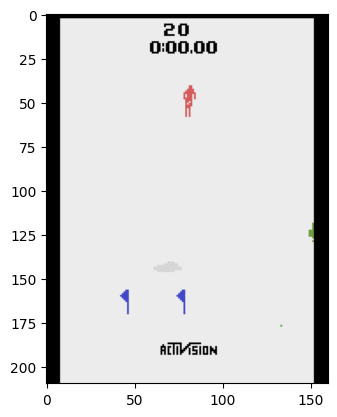

In [36]:
env = gym.make('ALE/Skiing-v5', render_mode="rgb_array")
# Wrap the environment with RecordVideo
# env = RecordVideo(env, "videos", episode_trigger=lambda x: x % 1 == 0)

# Reset the environment to get the initial observation
observation, info = env.reset()

# Render the initial observation
plt.imshow(observation)
plt.show()

In [37]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


### Model Code

In [38]:
# Deep Q Network
#
# This model is used to approximate the Q function

class DQN(nn.Module):
    def __init__(self, input_shape, num_actions):
        super(DQN, self).__init__()
        self.input_shape = input_shape
        self.num_actions = num_actions
        self.features = nn.Sequential(
            nn.Conv2d(input_shape[2], 32, kernel_size=8, stride=4),
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1),
            nn.ReLU(),
            nn.Flatten()
        )

        # Calculate the size of the output from the convolutional layers
        conv_out_size = self._get_conv_out_size(input_shape)

        self.fc = nn.Sequential(
            nn.Linear(conv_out_size, 512),
            nn.ReLU(),
            nn.Linear(512, num_actions)
        )

    def _get_conv_out_size(self, shape):
        o = self.features(torch.zeros(shape[2], shape[0], shape[1]))
        return int(torch.prod(torch.tensor(o.size()))) # Get size of flattened vector

    def forward(self, x):
        x = x.permute(0, 3, 1, 2) # Permute to (batch_size, channels, height, width)
        features = self.features(x)
        return self.fc(features)

In [39]:
# Defining memory class for experience replay
from collections import deque
import random

class ReplayMemory(): # Deque containing some past experience where experience is a tuple (state,action,new_state,reward,terminated)
  def __init__(self, maxlen):
    self.memory = deque([],maxlen)

  def append(self, experience): #add experience to deque
    self.memory.append(experience)

  def sample(self, batch_size):  #return a random sample of experience, useful to ensure non correlation as experience is time-correlated
    return random.sample(self.memory, batch_size)

  def __len__(self): #returns length of deque
    return len(self.memory)

In [40]:
class SkiingDQL():
  #Hyperparameter: turn this into function arg later
  lr = 0.0001
  discount_factor = 0.99
  network_sync_rate = 1000 #number of steps agent takes before we sync the policy and target networks
  replay_memory_size = 100000
  mini_batch_size = 64 #refers to size of batch sampled from replay memory

  env = gym.make('ALE/Skiing-v5', render_mode="rgb_array")
  num_states = env.observation_space.shape
  num_actions =3
  input_space = env.observation_space.shape

   #Create the two networks
  policy_network = DQN(input_space, num_actions).to(device)
  target_network = DQN(input_space, num_actions).to(device)

  loss = nn.MSELoss()
  optimizer = torch.optim.Adam(policy_network.parameters())

  ACTIONS = ["Left","Right","No_Action"]

  def optimize(self,mini_batch,policy_network,target_network):

    current_q_list = []
    target_q_list = []

    ##optimize policy network
    self.optimizer.zero_grad()

    states,actions,new_states,rewards,terminated = zip(*mini_batch)

    states = torch.stack([torch.from_numpy(arr.astype(np.float32) / 255.0) for arr in states]).to(device)
    new_states = torch.stack([torch.from_numpy(arr.astype(np.float32) / 255.0) for arr in new_states]).to(device)
    actions = torch.tensor(actions, dtype=torch.long).to(device)
    rewards = torch.tensor(rewards, dtype=torch.float32).to(device)
    terminated = torch.tensor(terminated, dtype=torch.bool).to(device)

    rewards = (rewards - rewards.mean()) / (rewards.std() + 1e-5)

    # Calculate target Q-values
    with torch.no_grad():
        next_q_values = target_network(new_states)
        max_next_q_values = next_q_values.max(1)[0]
        targets = rewards + (1 - terminated.float()) * self.discount_factor * max_next_q_values

    # Get current Q-values
    current_q_values = policy_network(states)
    current_q_values = current_q_values.gather(1, actions.unsqueeze(1)).squeeze(1)

    # Compute loss
    loss = self.loss(current_q_values, targets)

    # Backpropagation and optimization
    loss.backward()
    self.optimizer.step()

  def train(self, episodes):


    epsilon = 0.999 #
    memory = ReplayMemory(self.replay_memory_size) #creating memory of experience



    self.target_network.load_state_dict(self.policy_network.state_dict()) #Copying the weights so that the networks are the same

    rewards_per_episode = np.zeros(episodes)
    epsilon_decays = []
    step_count = 0
    total_steps = 0
    # Create progress bar for episodes
    with tqdm(total=episodes, desc="Training Progress") as pbar:
        for i in range(episodes):
            state, _ = self.env.reset()
            terminated = False
            truncated = False
            episode_steps = 0
            # Create progress bar for steps within an episode
            with tqdm(total=None, desc=f"Episode {i+1}", leave=False) as episode_pbar:
                while not terminated and not truncated:
                    if random.random() < epsilon:
                        action = self.env.action_space.sample()
                    else:
                        with torch.no_grad():
                            state_t = torch.tensor(state, dtype=torch.float32).to(device) /255.0
                            state_t = torch.unsqueeze(state_t, 0)
                            action = self.policy_network(state_t).argmax().item()
                    new_state, reward, terminated, truncated, _ = self.env.step(action)
                    memory.append((state, action, new_state, reward, terminated))
                    state = new_state
                    step_count += 1
                    total_steps += 1
                    episode_steps += 1
                    rewards_per_episode[i] += reward
                    if len(memory) > self.mini_batch_size:
                        mini_batch = memory.sample(self.mini_batch_size)
                        self.optimize(mini_batch, self.policy_network, self.target_network)
                        epsilon = max(epsilon - (1 / (episodes * 1000)), 0.01)
                        epsilon_decays.append(epsilon)
                        if step_count > self.network_sync_rate:
                            self.target_network.load_state_dict(self.policy_network.state_dict())
                            step_count = 0
                    # Update episode progress bar
                    episode_pbar.update(1)
                    episode_pbar.set_postfix({"Reward": f"{rewards_per_episode[i]:.2f}", "Epsilon": f"{epsilon:.2f}"})
                    if terminated or truncated:
                      break
            # Update main progress bar
            pbar.update(1)
            pbar.set_postfix({"Total Steps": total_steps, "Avg Reward": f"{np.mean(rewards_per_episode[:i+1]):.2f}"})
            # Small delay to allow for visual updates
            time.sleep(0.1)
    print(f"Total reward: {np.sum(rewards_per_episode)}")
    print(f"Average reward per episode: {np.mean(rewards_per_episode)}")

### Train Model

In [41]:
agent = SkiingDQL()
agent.train(episodes=100)

Training Progress:   0%|          | 0/100 [00:00<?, ?it/s]

Episode 1: 0it [00:00, ?it/s]

Episode 2: 0it [00:00, ?it/s]

Episode 3: 0it [00:00, ?it/s]

KeyboardInterrupt: 

## Data Collection

Heuristic Policy

In [43]:
import cv2

def crop_and_scale_batch(images):
    # Get the dimensions of the input images
    n, h, w, c = images.shape

    # Define crop dimensions
    crop_top, crop_bottom = 4, h - 4
    crop_left, crop_right = 15, w - 15

    # Crop all images in the batch
    cropped = images[:, crop_top:crop_bottom, crop_left:crop_right, :]

    # Prepare an output array for the scaled images
    scaled = np.zeros((n, 256, 256, c), dtype=np.float32)

    # Scale each image in the batch
    for i in range(n):
        scaled[i] = cv2.resize(cropped[i], (256, 256), interpolation=cv2.INTER_AREA)

    # Convert to uint8
    scaled = (scaled * 255.0).astype(np.uint8)

    return scaled

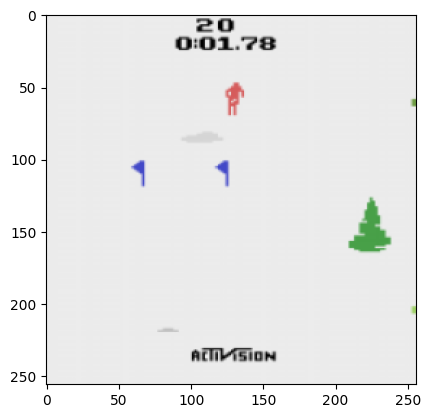

In [44]:
%matplotlib inline
import matplotlib.pyplot as plt
from IPython import display

import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchinfo import summary
import gymnasium as gym
from gymnasium.wrappers import AtariPreprocessing

from tqdm.notebook import tqdm
from torch.utils.tensorboard import SummaryWriter
import datetime

env_name = "ALE/Skiing-v5"
env = gym.make(env_name, render_mode="rgb_array")

env = AtariPreprocessing(env, grayscale_obs=False, frame_skip=1, scale_obs=True, screen_size=256)

sample, _ = env.reset()
img = crop_and_scale_batch(np.expand_dims(sample,(0)))[0]
plt.imshow(img)
plt.show()

### Collect Episode and Save

This saves the collected data to Google Drive

In [45]:
def pre_processing(observe):
    import cv2
    return cv2.resize(observe[40:-40, 10:-10], (64, 64))

def batch(obss, acts, seq_len, batch_size=64):
    ids = np.random.choice(seq_len, batch_size, replace=False)
    b_o = obss[-seq_len:][ids]
    b_a = acts[-seq_len:][ids]
    return torch.FloatTensor(b_o).to(device), torch.LongTensor(b_a).to(device)

def get_pos_player(observe):
    observe_int = (observe * 255).astype(np.uint8)
    ids = np.where(np.sum(observe_int == [214, 92, 92], -1) == 3)
    return ids[0].mean(), ids[1].mean()

def get_pos_flags(observe):
    observe_int = (observe * 255).astype(np.uint8)
    if np.any(np.sum(observe_int == [184, 50, 50], -1) == 3):
        ids = np.where(np.sum(observe_int == [184, 50, 50], -1) == 3)
        return ids[0].mean(), ids[1].mean()
    else:
        base = 0
        ids = np.where(np.sum(observe_int[base:-60] == [66, 72, 200], -1) == 3)
        return ids[0].mean() + base, ids[1].mean()

def get_speed(observe, observe_old):
    min_val = np.inf
    min_idx = 0
    for k in range(0, 7):
        val = np.sum(np.abs(observe[40:-40, 10:-10] - observe_old[40+k:-40+k,10:-10]))
        if min_val > val:
            min_idx = k
            min_val = val
    return min_idx

In [ ]:
import os
import numpy as np
import datetime
from torch.utils.tensorboard import SummaryWriter
from google.colab import drive
import tempfile

# Mount Google Drive
drive.mount('/content/drive')

# Constants for data storage
SHARD_SIZE = 2000  # Number of samples per shard
VALIDATION_SPLIT = 0.2  # 20% of episodes for validation

# Set the base directory in your Google Drive
BASE_DIR = '/content/drive/MyDrive/skiing_agent_data_scale_256_random'

class DataCollector:
    def __init__(self, is_validation=False):
        self.is_validation = is_validation
        subfolder = 'val' if is_validation else 'train'
        self.obs_dir = os.path.join(BASE_DIR, subfolder, 'observations')
        self.act_dir = os.path.join(BASE_DIR, subfolder, 'actions')

        # Create directories if they don't exist
        os.makedirs(self.obs_dir, exist_ok=True)
        os.makedirs(self.act_dir, exist_ok=True)

        # Initialize buffers
        self.obs_buffer = []
        self.act_buffer = []
        self.current_shard = 0

    def add_sample(self, observation, action):
        self.obs_buffer.append(observation)
        self.act_buffer.append(action)

        if len(self.obs_buffer) >= SHARD_SIZE:
            self.save_shard()

    def save_shard(self):
        if len(self.obs_buffer) == 0:
            return

        # Save observations
        obs_filename = os.path.join(self.obs_dir, f'frames_shard_{self.current_shard}.npy')
        np.save(obs_filename, np.array(crop_and_scale_batch(np.array(self.obs_buffer))))

        # Save actions
        act_filename = os.path.join(self.act_dir, f'actions_shard_{self.current_shard}.npy')
        np.save(act_filename, np.array(self.act_buffer))

        # Clear buffers
        self.obs_buffer = []
        self.act_buffer = []
        self.current_shard += 1

    def __del__(self):
        # Save any remaining data when the collector is destroyed
        self.save_shard()

# Initialize TensorBoard writer
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = f'/content/drive/MyDrive/tensorboard_logs/skiing_agent_{current_time}'
writer = SummaryWriter(log_dir)

# Initialize data collectors
train_collector = DataCollector()
validation_collector = DataCollector(is_validation=True)

# Main training loop
total_steps = 0
episodes = 100

with tqdm(total=episodes, desc="Training Progress") as pbar:
    for episode in range(episodes):
        # Determine if this episode is for validation
        is_validation = np.random.rand() < VALIDATION_SPLIT
        collector = validation_collector if is_validation else train_collector

        observe, _ = env.reset()
        step = 0
        cnt = 0
        done = False
        r_a, c_a = get_pos_player(observe)
        r_f, c_f = get_pos_flags(observe)
        r_a_old, c_a_old = r_a, c_a
        observe_old = observe

        episode_reward = 0
        p = 0.3

        # Create progress bar for steps within an episode
        with tqdm(total=None, desc=f"{'Validation' if is_validation else 'Training'} Episode {episode+1}", leave=False) as episode_pbar:
            while not done:
                step += 1
                total_steps += 1

                # TEACHER
                v_f = np.arctan2(r_f - r_a, c_f - c_a)
                spd = get_speed(observe, observe_old)
                v_a = np.arctan2(spd, c_a - c_a_old)
                observe_old = observe

                if spd == 0 and (c_a - c_a_old) == 0:
                    cnt += 1
                else:
                    cnt = 0

                if v_f - v_a < -0.1:
                    act_t = 1
                elif v_f - v_a > 0.1:
                    act_t = 2
                else:
                    act_t = 0

                if cnt > 20:
                    break
                r_a_old, c_a_old = r_a, c_a

                # Get action and store data
                act = np.random.choice(3) if np.random.rand() < p else act_t

                # Store the current observation and action
                collector.add_sample(observe, act)

                # Take step in environment
                observe, reward, terminated, truncated, info = env.step(act)
                done = terminated or truncated
                episode_reward += reward
                r_a, c_a = get_pos_player(observe)
                r_f, c_f = get_pos_flags(observe)

                # Update episode progress bar
                episode_pbar.update(1)
                episode_pbar.set_postfix({"Reward": f"{episode_reward:.2f}", "Steps": step})

        # Update main progress bar
        pbar.update(1)
        pbar.set_postfix({"Total Steps": total_steps, "Reward": f"{episode_reward:.2f}"})

# Save any remaining data and close the TensorBoard writer
del train_collector
del validation_collector
writer.close()